In [85]:
# Imports
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.linear_model import LinearRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor, OLSInfluence

%config InlineBackend.figure_formats = ['svg']  # or svg
%matplotlib inline
#'axes.facecolor':'#2b41bc'
sns.set(context='notebook', style='darkgrid', font_scale=0.8, rc={'axes.facecolor':'#2b41bc', 'axes.grid.which': 'major', 'figure.facecolor':'#ffffff', 'grid.color': '#ffffff'})

## MVP - Spotify song popularity predictor
### Importing and cleaning data

For this project I am training a model using Spotify track metadata to predict a song's popularity. I have a dataset of 4963 rows and 13 numerical features. 

The dataset was acquired as follows:

- 1277 rows were scraped from the Spotify Top 200 weekly charts for the year between 09-01-2021 and 09-01-2020
- 4099 rows were scraped from Spotify's API using random search terms
- 413 duplicate rows were removed

The target is the variable `popularity` which is calculated by Spotify based on an algorithm that includes current listening numbers, which indicates that `popularity` is a time-based measure, e.g. older tracks will likely have lower popularity scores.

In [86]:
# import data

df = pd.read_csv('/Users/joycetagal/Github/metis/reg/spotify_final_final_final_data.csv')

In [87]:
df.shape

(4963, 18)

In [88]:
df.tail()

,artist_name,track_name,track_id,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genres
4958,5ive,Me and My Brother,0AZYhsESBrtRq88nxq6GMZ,69,0.766,0.535,0.0,-7.607,0.0,0.0691,0.5990,0.000000,0.100,0.389,130.053,4.0,212.532,['st louis rap']
4959,Lil Tjay,Zoo York (feat. Fivio Foreign & Pop Smoke),3Ddny34bFoYBb8dIGq5lwp,69,0.565,0.569,6.0,-6.084,0.0,0.3790,0.0352,0.000009,0.106,0.303,92.466,5.0,214.825,"['brooklyn drill', 'melodic rap', 'nyc rap']"
4960,Tory Lanez,And This is Just The Intro,4sMmYKC0ot3GTbl2RzHw7T,66,0.530,0.517,5.0,-9.253,0.0,0.3990,0.3870,0.000000,0.176,0.381,137.554,4.0,326.813,"['canadian hip hop', 'canadian trap', 'hip hop..."
4961,Isaiah Rashad,Wat's Wrong (feat. Zacari & Kendrick Lamar),2RPbEp0DyBVlkRvvYKopO7,66,0.706,0.688,1.0,-6.357,1.0,0.2690,0.1510,0.000000,0.466,0.313,125.966,4.0,330.783,"['hip hop', 'rap', 'tennessee hip hop', 'under..."
4962,Brooks & Dunn,My Maria,09qzRI951OVkXGCc33gzcT,68,0.673,0.842,3.0,-4.627,1.0,0.0366,0.0600,0.000257,0.178,0.898,125.570,4.0,208.107,"['contemporary country', 'country', 'country r..."


In [89]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4963 entries, 0 to 4962
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist_name       4963 non-null   object 
 1   track_name        4963 non-null   object 
 2   track_id          4963 non-null   object 
 3   popularity        4963 non-null   int64  
 4   danceability      4963 non-null   float64
 5   energy            4963 non-null   float64
 6   key               4962 non-null   float64
 7   loudness          4962 non-null   float64
 8   mode              4962 non-null   float64
 9   speechiness       4963 non-null   float64
 10  acousticness      4963 non-null   float64
 11  instrumentalness  4963 non-null   float64
 12  liveness          4963 non-null   float64
 13  valence           4963 non-null   float64
 14  tempo             4962 non-null   float64
 15  time_signature    4962 non-null   float64
 16  duration          4962 non-null   float64


In [90]:
df.dropna(inplace=True)

In [91]:
# coerce some categoricals to in
spotify_df = df.astype({'key': int, 'mode': int, 'time_signature': int})

In [92]:
spotify_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4962 entries, 0 to 4962
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist_name       4962 non-null   object 
 1   track_name        4962 non-null   object 
 2   track_id          4962 non-null   object 
 3   popularity        4962 non-null   int64  
 4   danceability      4962 non-null   float64
 5   energy            4962 non-null   float64
 6   key               4962 non-null   int64  
 7   loudness          4962 non-null   float64
 8   mode              4962 non-null   int64  
 9   speechiness       4962 non-null   float64
 10  acousticness      4962 non-null   float64
 11  instrumentalness  4962 non-null   float64
 12  liveness          4962 non-null   float64
 13  valence           4962 non-null   float64
 14  tempo             4962 non-null   float64
 15  time_signature    4962 non-null   int64  
 16  duration          4962 non-null   float64


In [93]:
spotify_df.tail()

,artist_name,track_name,track_id,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genres
4958,5ive,Me and My Brother,0AZYhsESBrtRq88nxq6GMZ,69,0.766,0.535,0,-7.607,0,0.0691,0.5990,0.000000,0.100,0.389,130.053,4,212.532,['st louis rap']
4959,Lil Tjay,Zoo York (feat. Fivio Foreign & Pop Smoke),3Ddny34bFoYBb8dIGq5lwp,69,0.565,0.569,6,-6.084,0,0.3790,0.0352,0.000009,0.106,0.303,92.466,5,214.825,"['brooklyn drill', 'melodic rap', 'nyc rap']"
4960,Tory Lanez,And This is Just The Intro,4sMmYKC0ot3GTbl2RzHw7T,66,0.530,0.517,5,-9.253,0,0.3990,0.3870,0.000000,0.176,0.381,137.554,4,326.813,"['canadian hip hop', 'canadian trap', 'hip hop..."
4961,Isaiah Rashad,Wat's Wrong (feat. Zacari & Kendrick Lamar),2RPbEp0DyBVlkRvvYKopO7,66,0.706,0.688,1,-6.357,1,0.2690,0.1510,0.000000,0.466,0.313,125.966,4,330.783,"['hip hop', 'rap', 'tennessee hip hop', 'under..."
4962,Brooks & Dunn,My Maria,09qzRI951OVkXGCc33gzcT,68,0.673,0.842,3,-4.627,1,0.0366,0.0600,0.000257,0.178,0.898,125.570,4,208.107,"['contemporary country', 'country', 'country r..."


## Visualizing and exploring data
### Covariance, Correlation, and Collinearity

In [94]:
spotify_df = spotify_df.select_dtypes(exclude=['object']).copy() # Drop non-numerical columns
#spotify_df = spotify_df.drop( # Drop confidence columns
#    columns=['tempo_confidence', 'time_signature_confidence', 'key_confidence', 'mode_confidence'] 
#)

In [95]:
spotify_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4962 entries, 0 to 4962
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        4962 non-null   int64  
 1   danceability      4962 non-null   float64
 2   energy            4962 non-null   float64
 3   key               4962 non-null   int64  
 4   loudness          4962 non-null   float64
 5   mode              4962 non-null   int64  
 6   speechiness       4962 non-null   float64
 7   acousticness      4962 non-null   float64
 8   instrumentalness  4962 non-null   float64
 9   liveness          4962 non-null   float64
 10  valence           4962 non-null   float64
 11  tempo             4962 non-null   float64
 12  time_signature    4962 non-null   int64  
 13  duration          4962 non-null   float64
dtypes: float64(10), int64(4)
memory usage: 581.5 KB


<AxesSubplot:xlabel='popularity', ylabel='Count'>

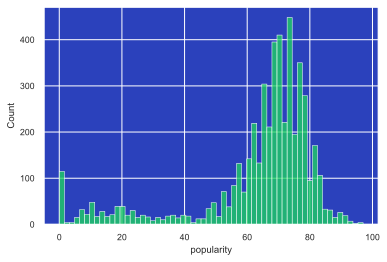

In [96]:
sns.histplot(spotify_df['popularity'], color='#1ed65f')

In [97]:
spotify_df.corr()

,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration
popularity,1.000000,0.069550,0.118924,0.011185,0.227165,-0.009288,-0.040619,-0.165976,-0.217257,-0.074795,-0.027077,0.027723,0.020048,0.006033
danceability,0.069550,1.000000,0.134050,0.029929,0.334924,-0.107095,0.288812,-0.285468,-0.267081,-0.135457,0.337778,-0.023435,0.182549,-0.129847
energy,0.118924,0.134050,1.000000,0.024060,0.690786,-0.046800,0.037519,-0.607356,-0.224419,0.169293,0.367500,0.159146,0.148790,0.063647
key,0.011185,0.029929,0.024060,1.000000,0.006729,-0.161346,0.027796,-0.008804,0.019555,-0.008816,0.042931,0.027980,0.024620,-0.006454
loudness,0.227165,0.334924,0.690786,0.006729,1.000000,-0.035437,0.063234,-0.519205,-0.515050,0.040474,0.276433,0.150015,0.175031,0.088105
mode,-0.009288,-0.107095,-0.046800,-0.161346,-0.035437,1.000000,-0.105569,0.048548,0.005722,-0.010735,-0.001841,0.017846,-0.022827,-0.018023
speechiness,-0.040619,0.288812,0.037519,0.027796,0.063234,-0.105569,1.000000,-0.133104,-0.122234,0.051591,0.015004,0.133436,0.061503,-0.132473
acousticness,-0.165976,-0.285468,-0.607356,-0.008804,-0.519205,0.048548,-0.133104,1.000000,0.229167,-0.028515,-0.140454,-0.151113,-0.171719,-0.038621
instrumentalness,-0.217257,-0.267081,-0.224419,0.019555,-0.515050,0.005722,-0.122234,0.229167,1.000000,-0.016490,-0.183247,-0.051397,-0.096085,-0.057948
liveness,-0.074795,-0.135457,0.169293,-0.008816,0.040474,-0.010735,0.051591,-0.028515,-0.016490,1.000000,0.008057,0.015485,-0.024500,0.002610


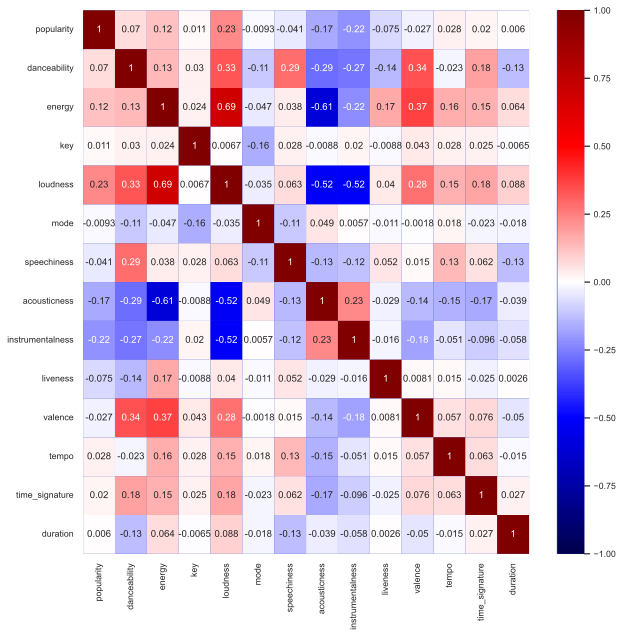

In [98]:
f, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(spotify_df.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1);

In [99]:
spotify_df.corr()['popularity'].sort_values(ascending=False)

popularity          1.000000
loudness            0.227165
energy              0.118924
danceability        0.069550
tempo               0.027723
time_signature      0.020048
key                 0.011185
duration            0.006033
mode               -0.009288
valence            -0.027077
speechiness        -0.040619
liveness           -0.074795
acousticness       -0.165976
instrumentalness   -0.217257
Name: popularity, dtype: float64

Simply based on the correlations plot, it looks as if the correlations for our target `popularity` are weak, with the highest correlation being `loudness` with 0.22 correlation. Let's use Seaborn to pairplot the variables with the highest correlation scores.

In [100]:
sns.pairplot(spotify_df[['popularity', 'loudness', 'energy', 'liveness', 'acousticness', 'instrumentalness']])

Similarly from the correlations calculations, we can see that for `popularity`, the correlations with our selected features seem tenuous. Some other things to note:

- The variables `energy` and `loudness` are positively correlated, which makes intuitive sense.
- The variables `acousticness` and `energy` seem to be negatively correlated, which also makes sense
- The other variables also don't seen to have a strong relationship. 

Intuitively, we can presume that the random selection of songs we have chosen are from a diverse set of genres, and therefore, will be 'popular' with listeners based on a number of different traits. 

Let's do an initial model and then try a subset of data within a specific genre.

## Initial model

In [101]:
x_df = spotify_df.drop(columns=['popularity'])
y_df = spotify_df['popularity']
lm = LinearRegression()
sk_fit = lm.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.0937843901868447

Looks like our initial R^2 is very low and explains about 10% of the variance between actual and target values. This model uses all the features present. Let's try to use a smaller set of only the highly correlated variables.

In [102]:
x_df = spotify_df[['loudness', 'energy', 'liveness', 'acousticness', 'instrumentalness']]
y_df = spotify_df['popularity']

lm_selected = LinearRegression()
sk_fit = lm_selected.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.0779413699512167

As expected, the R^2 value drops when we remove some features. Let's stick with the smaller number of features for now.

In [103]:
#Create the model
model = sm.OLS(y_df, sm.add_constant(x_df))

#Fit
fit = model.fit()

#Print out summary
fit.summary()

/Users/joycetagal/opt/anaconda3/envs/metis/lib/python3.8/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             popularity   R-squared:                       0.078
Model:                            OLS   Adj. R-squared:                  0.077
Method:                 Least Squares   F-statistic:                     83.79
Date:                Tue, 12 Oct 2021   Prob (F-statistic):           9.56e-85
Time:                        16:54:45   Log-Likelihood:                -21654.
No. Observations:                4962   AIC:                         4.332e+04
Df Residuals:                    4956   BIC:                         4.336e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               77.3056      1.948     39.682      0.000      73.486      81.125
loudness             0.7492      0.105      7.153      0.000       0.544       0.954
energy              -6.5045      2.146     -3.030      0.002     -10.713      -2.297
liveness           -10.0969      1.881     -5.369      0.000     -13.784      -6.410
acousticness        -6.7277      1.232     -5.460      0.000      -9.143      -4.312
instrumentalness   -14.5328      1.833     -7.928      0.000     -18.126     -10.939
==============================================================================
Omnibus:                     1455.497   Durbin-Watson:                   0.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3535.182
Skew:                          -1.635   Prob(JB):                         0.00
Kurtosis:                       5.532   Cond. No.                         95.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Checking residual plots

The JB p-value is 0, which indicates non-normality of errors. Let's check residual plots.

In [104]:
def diagnostic_plots(y_pred, y_true, resid):
    fig, axes = plt.subplots(1, 3, figsize=(10, 4))

    g1 = sns.regplot(x=y_pred, y=y_true, ci=False, line_kws={'color': 'red'}, ax=axes[0], scatter_kws={'s': 5, 'color': '#1ed65f'})
    g1.set_xlabel('Predicted Target')
    g1.set_ylabel('True Target')
    g1.set_title('Regression fit')

    g2 = sns.regplot(x=y_pred, y=resid, lowess=True, ax=axes[1], line_kws={'color': 'red'}, scatter_kws={'s': 5})
    g2.set_xlabel('Predicted Target')
    g2.set_ylabel('Residual')
    g2.axhline(y=0, color='gray', linestyle='--')
    g2.set_title('Residual plot')

    stats.probplot(resid, dist="norm", plot=axes[2])
    #plt.title("Normal Q-Q plot")

    fig.suptitle('Diagnostic Plots');
    fig.tight_layout();

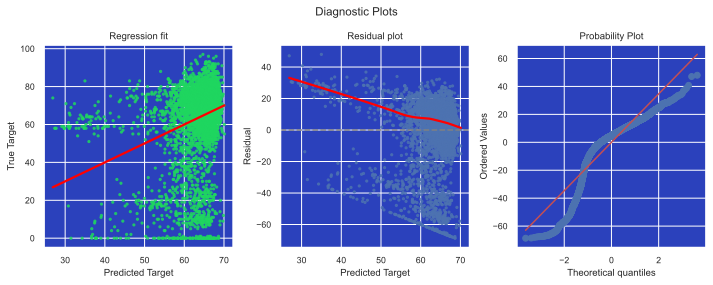

In [105]:
diagnostic_plots(fit.fittedvalues, y_df, fit.resid)

From the regression fit line, it looks like the predicted targets are all clustering around the `popularity` mean. The residuals plot also shows a clear trend line in the residual distribution. We should consider scaling or transforming the target.

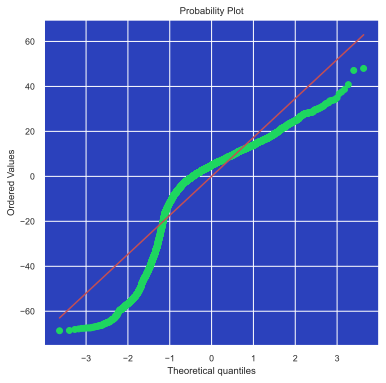

In [112]:
fig = plt.figure(figsize=[6, 6], dpi=100)
ax = fig.add_subplot(111)
fig = stats.probplot(fit.resid, dist="norm", plot=plt)

ax.get_lines()[0].set_markerfacecolor('#1ed65f')
ax.get_lines()[0].set_markeredgecolor('#1ed65f')

In [108]:
# remove zero values from df
spotify_df = spotify_df[spotify_df['popularity'] > 1]

<AxesSubplot:>

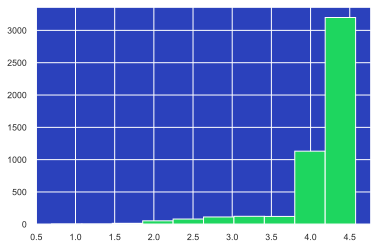

In [111]:
np.log(spotify_df['popularity']).hist(color = '#1ed65f')

### Variable Inflation Factor

In [42]:
def vif(df_X):
    '''
    Calculate the VIF for each feature of df_X (a Pandas DataFrame).
    '''
    vif_data = [variance_inflation_factor(df_X.values, i)
                for i in range(df_X.shape[1])]
    
    return pd.Series(vif_data, index=df_X.columns)

In [43]:
# We only analyze the VIF for predictors
vif(spotify_df.iloc[:, 1:])

danceability        21.400441
energy              24.521180
key                  3.168113
loudness             9.168738
mode                 2.858180
speechiness          2.353261
acousticness         2.993380
instrumentalness     1.561415
liveness             2.738522
valence              7.461045
tempo               17.529330
time_signature      70.599250
duration            11.462147
dtype: float64

# Try model with 'pop' genre only

In [77]:
pop_df = df[df['genres'].str.contains('pop')]

pop_df.shape

(2216, 18)

In [79]:
pop_df = pop_df.select_dtypes(exclude=['object']).copy()

In [81]:
pop_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 4960
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        2216 non-null   int64  
 1   danceability      2216 non-null   float64
 2   energy            2216 non-null   float64
 3   key               2216 non-null   float64
 4   loudness          2216 non-null   float64
 5   mode              2216 non-null   float64
 6   speechiness       2216 non-null   float64
 7   acousticness      2216 non-null   float64
 8   instrumentalness  2216 non-null   float64
 9   liveness          2216 non-null   float64
 10  valence           2216 non-null   float64
 11  tempo             2216 non-null   float64
 12  time_signature    2216 non-null   float64
 13  duration          2216 non-null   float64
dtypes: float64(13), int64(1)
memory usage: 259.7 KB


<AxesSubplot:xlabel='popularity', ylabel='Count'>

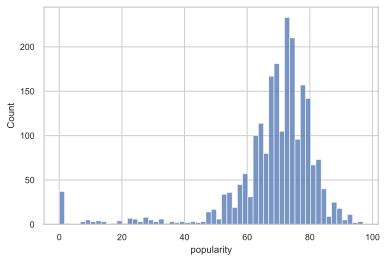

In [82]:
sns.histplot(pop_df['popularity'])

In [83]:
pop_df.corr()

,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration
popularity,1.000000,0.066549,-0.017100,0.031441,0.073115,-0.012535,-0.017990,-0.048490,-0.029595,-0.069339,-0.053477,0.010507,-0.013972,-0.051393
danceability,0.066549,1.000000,0.070643,0.053444,0.175715,-0.108904,0.231719,-0.237954,-0.106777,-0.069996,0.334482,-0.102771,0.166114,-0.146016
energy,-0.017100,0.070643,1.000000,0.041455,0.714790,-0.053585,0.047044,-0.600560,-0.051528,0.163470,0.449595,0.136151,0.152240,-0.013894
key,0.031441,0.053444,0.041455,1.000000,0.033504,-0.141607,0.032859,-0.015061,-0.000592,0.005598,0.065154,0.013367,0.050037,-0.067852
loudness,0.073115,0.175715,0.714790,0.033504,1.000000,-0.044220,0.044770,-0.525758,-0.197829,0.092895,0.274188,0.090085,0.108689,-0.082390
mode,-0.012535,-0.108904,-0.053585,-0.141607,-0.044220,1.000000,-0.106760,0.045869,0.016309,-0.039603,-0.046773,0.052976,-0.048893,0.011849
speechiness,-0.017990,0.231719,0.047044,0.032859,0.044770,-0.106760,1.000000,-0.089435,-0.060052,0.098338,0.034695,0.127982,0.005908,-0.070210
acousticness,-0.048490,-0.237954,-0.600560,-0.015061,-0.525758,0.045869,-0.089435,1.000000,0.107286,-0.037755,-0.237718,-0.122238,-0.151288,-0.004484
instrumentalness,-0.029595,-0.106777,-0.051528,-0.000592,-0.197829,0.016309,-0.060052,0.107286,1.000000,-0.010050,-0.092822,0.037882,-0.018154,0.021356
liveness,-0.069339,-0.069996,0.163470,0.005598,0.092895,-0.039603,0.098338,-0.037755,-0.010050,1.000000,0.039053,0.030779,-0.005742,-0.020408


In [84]:
pop_df.corr()['popularity'].sort_values(ascending=False)

popularity          1.000000
loudness            0.073115
danceability        0.066549
key                 0.031441
tempo               0.010507
mode               -0.012535
time_signature     -0.013972
energy             -0.017100
speechiness        -0.017990
instrumentalness   -0.029595
acousticness       -0.048490
duration           -0.051393
valence            -0.053477
liveness           -0.069339
Name: popularity, dtype: float64

In [85]:
x_df = pop_df.drop(columns=['popularity'])
y_df = pop_df['popularity']
lm = LinearRegression()
sk_fit = lm.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.0310783078828194

In [86]:
#Create the model
model = sm.OLS(y_df, sm.add_constant(x_df)) 

#Fit
fit = model.fit()

#Print out summary
fit.summary()

/Users/joycetagal/opt/anaconda3/envs/metis/lib/python3.8/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             popularity   R-squared:                       0.031
Model:                            OLS   Adj. R-squared:                  0.025
Method:                 Least Squares   F-statistic:                     5.433
Date:                Mon, 11 Oct 2021   Prob (F-statistic):           9.14e-10
Time:                        20:18:25   Log-Likelihood:                -9104.6
No. Observations:                2216   AIC:                         1.824e+04
Df Residuals:                    2202   BIC:                         1.832e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               84.2775      5.683     14.829      0.000      73.132      95.423
danceability         7.0721      2.581      2.740      0.006       2.011      12.133
energy              -8.0242      3.107     -2.583      0.010     -14.116      -1.932
key                  0.1250      0.088      1.421      0.156      -0.048       0.298
loudness             0.7156      0.177      4.034      0.000       0.368       1.063
mode                -0.3192      0.664     -0.481      0.631      -1.622       0.984
speechiness         -5.8498      3.298     -1.774      0.076     -12.317       0.618
acousticness        -2.6330      1.576     -1.671      0.095      -5.723       0.457
instrumentalness    -0.9720      2.830     -0.344      0.731      -6.521       4.577
liveness            -6.4423      2.400     -2.684      0.007     -11.149      -1.736
valence             -5.2794      1.671     -3.159      0.002      -8.557      -2.002
tempo                0.0132      0.011      1.154      0.249      -0.009       0.036
time_signature      -1.2624      1.097     -1.150      0.250      -3.414       0.890
duration            -0.0129      0.007     -1.959      0.050      -0.026    1.39e-05
==============================================================================
Omnibus:                     1178.856   Durbin-Watson:                   1.060
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             8490.393
Skew:                          -2.452   Prob(JB):                         0.00
Kurtosis:                      11.240   Cond. No.                     4.81e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.81e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

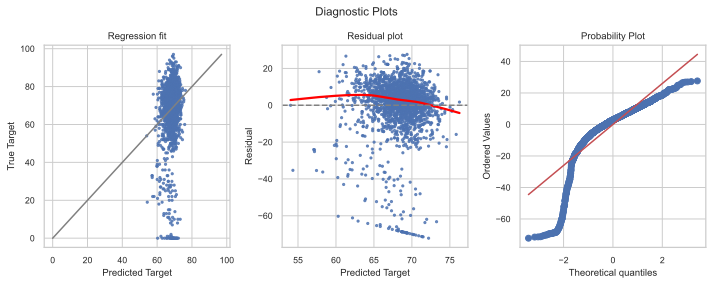

In [87]:
diagnostic_plots(fit.fittedvalues, y_df, fit.resid)

### Try rap genre only

In [136]:
rap_df = df[df['genres'].str.contains('rap')]

rap_df.shape

(1910, 18)

In [143]:
rap_df = rap_df.select_dtypes(exclude=['object']).copy()

<AxesSubplot:xlabel='popularity', ylabel='Count'>

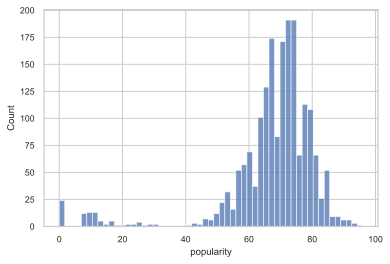

In [144]:
sns.histplot(rap_df['popularity'])

In [145]:
rap_df.corr()

,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration
popularity,1.000000,-0.062979,0.019670,0.029720,0.092168,-0.037247,-0.130153,0.060987,-0.011761,-0.002446,-0.004465,-0.022640,-0.012514,0.167737
danceability,-0.062979,1.000000,-0.098629,0.063485,0.003109,-0.051277,0.113055,-0.131038,-0.138663,-0.196233,0.260171,-0.039590,0.110645,-0.161647
energy,0.019670,-0.098629,1.000000,0.045443,0.690670,0.026870,-0.057846,-0.351911,-0.025198,0.176803,0.327652,0.065135,0.054562,0.148282
key,0.029720,0.063485,0.045443,1.000000,0.050056,-0.227424,0.020177,0.021593,-0.023953,-0.017641,0.118939,0.024715,0.039953,0.037499
loudness,0.092168,0.003109,0.690670,0.050056,1.000000,0.048682,-0.131888,-0.320600,-0.116456,0.060761,0.196859,0.048252,0.052235,0.174699
mode,-0.037247,-0.051277,0.026870,-0.227424,0.048682,1.000000,0.009405,-0.079351,-0.004653,0.025458,-0.053835,0.024932,-0.000640,-0.006397
speechiness,-0.130153,0.113055,-0.057846,0.020177,-0.131888,0.009405,1.000000,-0.025526,-0.061062,-0.001632,0.089088,0.145756,0.004552,-0.088008
acousticness,0.060987,-0.131038,-0.351911,0.021593,-0.320600,-0.079351,-0.025526,1.000000,0.065483,-0.010050,0.014979,-0.090804,-0.056833,-0.082354
instrumentalness,-0.011761,-0.138663,-0.025198,-0.023953,-0.116456,-0.004653,-0.061062,0.065483,1.000000,0.051836,-0.077151,-0.017261,-0.029484,-0.015182
liveness,-0.002446,-0.196233,0.176803,-0.017641,0.060761,0.025458,-0.001632,-0.010050,0.051836,1.000000,0.003909,-0.031196,0.000909,0.031829


In [147]:
x_df = rap_df.drop(columns=['popularity'])
y_df = rap_df['popularity']
lm = LinearRegression()
sk_fit = lm.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.057127640169736704